Analyzing user sentiments and performance of Threads

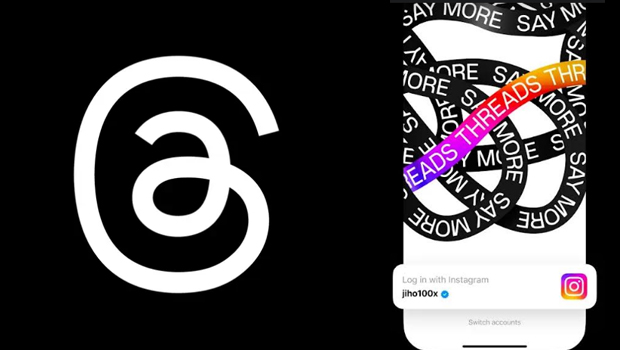

In [1]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go 

In [2]:
df = pd.read_csv("threads_reviews.csv")

In [3]:
df.head()

,source,review_description,rating,review_date
0,Google Play,Meh. Not the greatest experience on a Chromebo...,2,2023-07-08 14:18:24
1,Google Play,Pretty good for a first launch!! Its easy to u...,3,2023-07-19 20:52:48
2,Google Play,"For a brand new app, it's very well optimized....",3,2023-07-06 23:03:11
3,Google Play,"Great app with a lot of potential! However, th...",3,2023-07-10 00:53:25
4,Google Play,"The app is good, but it needs a lot of functio...",3,2023-07-06 16:57:43


In [4]:
df.tail()

,source,review_description,rating,review_date
32905,App Store,This killed my dog. Mark zuckerburg strangled ...,1,2023-07-06 01:23:55
32906,App Store,Add Search and hashtag like Twitter !,1,2023-07-19 08:01:06
32907,App Store,bad twister,1,2023-07-17 06:39:13
32908,App Store,Yet another trash from Meta.,1,2023-07-07 17:47:16
32909,App Store,Nothing special this app is just a copy of twi...,1,2023-07-07 07:01:43


In [5]:
df.shape

(32910, 4)

In [6]:
df.columns

Index(['source', 'review_description', 'rating', 'review_date'], dtype='object')

In [7]:
df.duplicated().sum()

1

In [8]:
df = df.drop_duplicates()

In [9]:
df.isnull().sum()

source                0
review_description    0
rating                0
review_date           0
dtype: int64

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 32909 entries, 0 to 32909
Data columns (total 4 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   source              32909 non-null  object
 1   review_description  32909 non-null  object
 2   rating              32909 non-null  int64 
 3   review_date         32909 non-null  object
dtypes: int64(1), object(3)
memory usage: 1.3+ MB


In [11]:
df.describe()

,rating
count,32909.000000
mean,3.398432
std,1.751484
min,1.000000
25%,1.000000
50%,4.000000
75%,5.000000
max,5.000000


In [12]:
df.nunique()

source                    2
review_description    26706
rating                    5
review_date           31667
dtype: int64

In [13]:
df['review_description'].duplicated().sum()

6203

In [14]:
df['source'].unique()

array(['Google Play', 'App Store'], dtype=object)

In [15]:
df['source'].value_counts()

source
Google Play    30270
App Store       2639
Name: count, dtype: int64

C:\Users\Pallavi\AppData\Local\Temp\ipykernel_12836\4241419227.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x = df['source'], data = df, palette = 'hls')


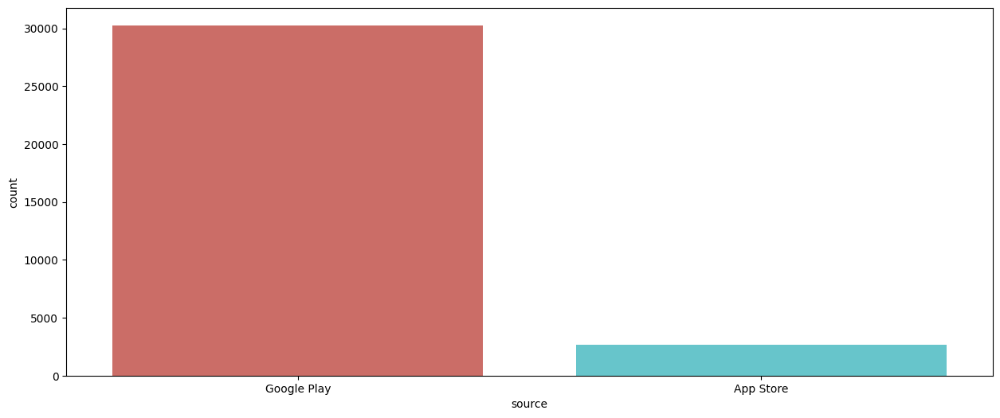

In [16]:
plt.figure(figsize = (15, 6))
sns.countplot(x = df['source'], data = df, palette = 'hls')
plt.show()

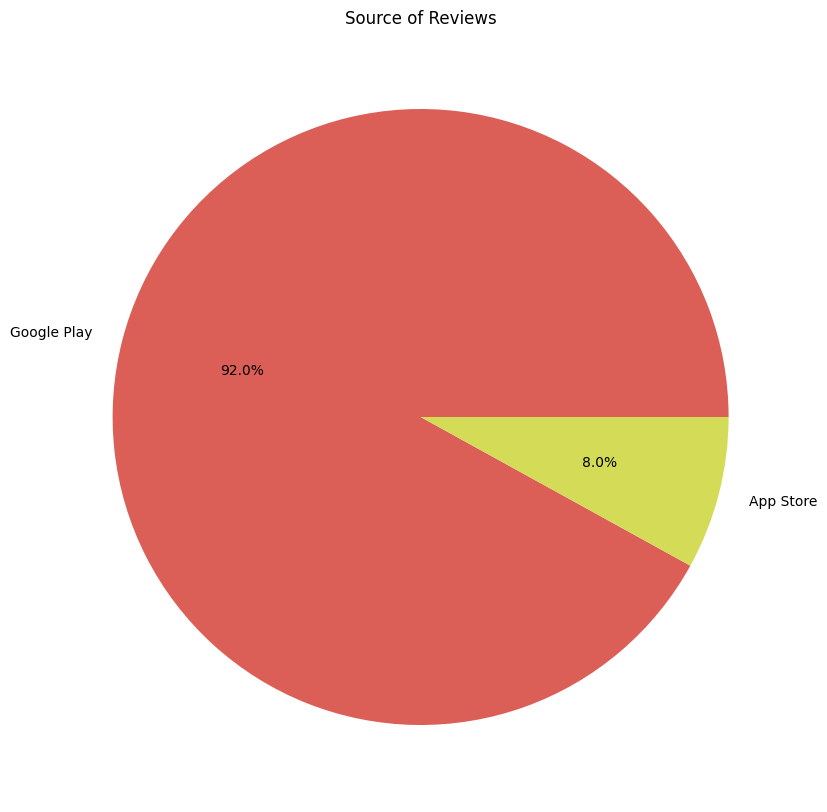

In [17]:
plt.figure(figsize = (10, 10))
counts = df['source'].value_counts()
plt.pie(counts, labels = counts.index, autopct = '%1.1f%%', colors = sns.color_palette('hls'))
plt.title('Source of Reviews')
plt.show()

In [18]:
fig = go.Figure(data=[go.Bar(x=df['source'].value_counts().index, y=df['source'].value_counts())])
fig.update_layout(title='Source of Reviews',xaxis_title="Source",yaxis_title="Count")
fig.show()

In [19]:
counts = df['source'].value_counts()
fig = go.Figure(data=[go.Pie(labels=counts.index, values=counts)])
fig.update_layout(title='Source of Reviews')
fig.show()

In [20]:
df['rating'].unique()

array([2, 3, 1, 5, 4], dtype=int64)

In [21]:
df['rating'].value_counts()

rating
5    15558
1     9726
4     3244
3     2585
2     1796
Name: count, dtype: int64

C:\Users\Pallavi\AppData\Local\Temp\ipykernel_12836\1760075616.py:2: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




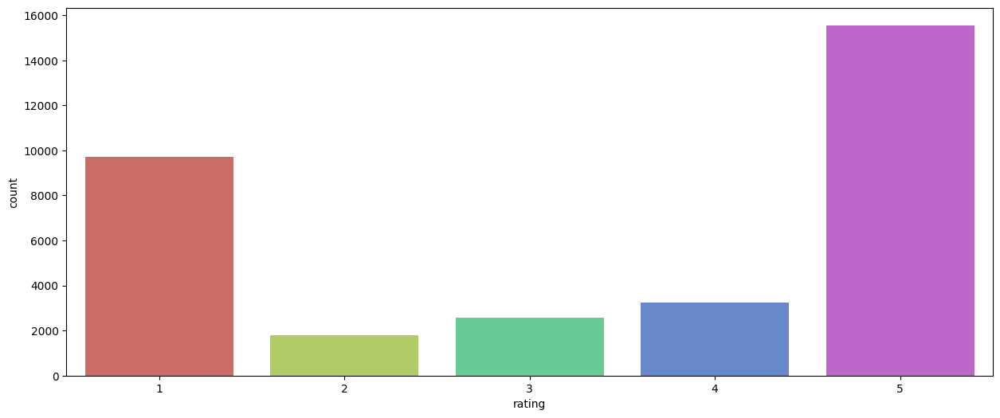

In [22]:
plt.figure(figsize=(15,6))
sns.countplot(x = df['rating'], data = df, palette = 'hls')
plt.show()

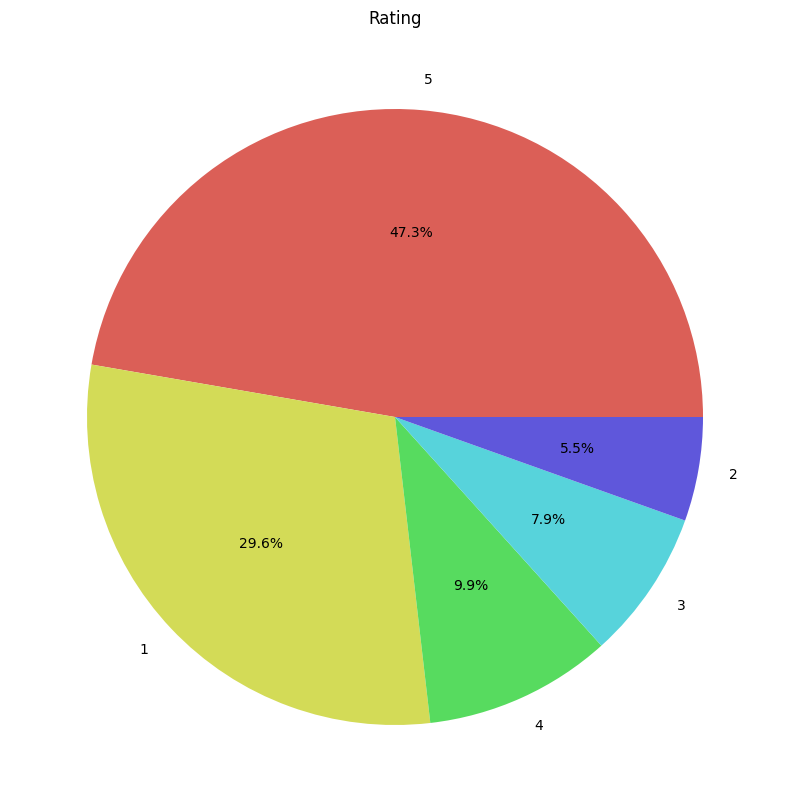

In [23]:
plt.figure(figsize=(10, 10))
counts = df['rating'].value_counts()
plt.pie(counts, labels=counts.index, autopct='%1.1f%%', colors=sns.color_palette('hls'))
plt.title('Rating')
plt.show()

In [24]:
fig = go.Figure(data=[go.Bar(x=df['rating'].value_counts().index, y=df['rating'].value_counts())])
fig.update_layout(title='Rating',xaxis_title="Rating",yaxis_title="Count")
fig.show()

In [25]:
counts = df['rating'].value_counts()
fig = go.Figure(data=[go.Pie(labels=counts.index, values=counts)])
fig.update_layout(title='Rating')
fig.show()

In [26]:
df['review_date'] = pd.to_datetime(df['review_date'])

In [27]:
df['review_date']

0       2023-07-08 14:18:24
1       2023-07-19 20:52:48
2       2023-07-06 23:03:11
3       2023-07-10 00:53:25
4       2023-07-06 16:57:43
                ...        
32905   2023-07-06 01:23:55
32906   2023-07-19 08:01:06
32907   2023-07-17 06:39:13
32908   2023-07-07 17:47:16
32909   2023-07-07 07:01:43
Name: review_date, Length: 32909, dtype: datetime64[ns]

In [28]:
df1 = df.copy()

In [29]:
df1.set_index('review_date', inplace = True)

In [30]:
df1.head()

,source,review_description,rating
review_date,,,
2023-07-08 14:18:24,Google Play,Meh. Not the greatest experience on a Chromebo...,2
2023-07-19 20:52:48,Google Play,Pretty good for a first launch!! Its easy to u...,3
2023-07-06 23:03:11,Google Play,"For a brand new app, it's very well optimized....",3
2023-07-10 00:53:25,Google Play,"Great app with a lot of potential! However, th...",3
2023-07-06 16:57:43,Google Play,"The app is good, but it needs a lot of functio...",3


In [31]:
df1.tail()

,source,review_description,rating
review_date,,,
2023-07-06 01:23:55,App Store,This killed my dog. Mark zuckerburg strangled ...,1
2023-07-19 08:01:06,App Store,Add Search and hashtag like Twitter !,1
2023-07-17 06:39:13,App Store,bad twister,1
2023-07-07 17:47:16,App Store,Yet another trash from Meta.,1
2023-07-07 07:01:43,App Store,Nothing special this app is just a copy of twi...,1


In [32]:
start_date = df1.index.min()
end_date = df1.index.max()

In [33]:
start_date

Timestamp('2023-07-05 22:53:12')

In [34]:
end_date

Timestamp('2023-07-25 09:42:20')

In [35]:
week_delta = pd.Timedelta(days = 6)
current_date = start_date

In [36]:
week_delta

Timedelta('6 days 00:00:00')

In [37]:
while current_date <= end_date:
    start_week = current_date
    print('start:', start_week)
    end_week = current_date + week_delta
    print('end:', end_week)
    current_week_data = df1[(df1.index >= start_week) & (df1.index < end_week)]
    print('currentdata\n', current_week_data)
    weekly_counts = current_week_data.resample('D').size()
    print('weekly', weekly_counts) 
    fig = px.bar(weekly_counts, x = weekly_counts.index, y = weekly_counts.values,
                labels = {'x': 'Date', 'y': 'Number of Reviews'}, 
                title=f'Reviews for Week {start_week.strftime("%Y-%m-%d")} to {end_week.strftime("%Y-%m-%d")}')
    fig.update_layout(xaxis_tickangle=-45)
    fig.show()
    current_date += week_delta
    
    

start: 2023-07-05 22:53:12
end: 2023-07-11 22:53:12
currentdata
                           source  \
review_date                        
2023-07-08 14:18:24  Google Play   
2023-07-06 23:03:11  Google Play   
2023-07-10 00:53:25  Google Play   
2023-07-06 16:57:43  Google Play   
2023-07-06 14:35:15  Google Play   
...                          ...   
2023-07-07 11:59:07    App Store   
2023-07-06 21:51:55    App Store   
2023-07-06 01:23:55    App Store   
2023-07-07 17:47:16    App Store   
2023-07-07 07:01:43    App Store   

                                                    review_description  rating  
review_date                                                                     
2023-07-08 14:18:24  Meh. Not the greatest experience on a Chromebo...       2  
2023-07-06 23:03:11  For a brand new app, it's very well optimized....       3  
2023-07-10 00:53:25  Great app with a lot of potential! However, th...       3  
2023-07-06 16:57:43  The app is good, but it needs a lot of f

start: 2023-07-11 22:53:12
end: 2023-07-17 22:53:12
currentdata
                           source  \
review_date                        
2023-07-14 16:15:10  Google Play   
2023-07-14 00:12:32  Google Play   
2023-07-14 12:46:21  Google Play   
2023-07-15 18:37:18  Google Play   
2023-07-13 16:23:06  Google Play   
...                          ...   
2023-07-17 01:36:58    App Store   
2023-07-12 13:06:47    App Store   
2023-07-17 01:34:50    App Store   
2023-07-13 21:16:40    App Store   
2023-07-17 06:39:13    App Store   

                                                    review_description  rating  
review_date                                                                     
2023-07-14 16:15:10  Pointless in following anyone. The feed algo w...       1  
2023-07-14 00:12:32  It needs a lot of work. It constantly crashes,...       2  
2023-07-14 12:46:21  It's great, but there's a lot of QoL that can ...       3  
2023-07-15 18:37:18  It suddenly closes. I thought I just acc

start: 2023-07-17 22:53:12
end: 2023-07-23 22:53:12
currentdata
                           source  \
review_date                        
2023-07-19 20:52:48  Google Play   
2023-07-18 22:30:10  Google Play   
2023-07-19 19:35:31  Google Play   
2023-07-20 20:22:06  Google Play   
2023-07-22 20:20:32  Google Play   
...                          ...   
2023-07-19 02:47:03    App Store   
2023-07-20 04:46:29    App Store   
2023-07-18 10:22:35    App Store   
2023-07-18 17:47:46    App Store   
2023-07-19 08:01:06    App Store   

                                                    review_description  rating  
review_date                                                                     
2023-07-19 20:52:48  Pretty good for a first launch!! Its easy to u...       3  
2023-07-18 22:30:10  Currently, it's very challenging to use. It's ...       2  
2023-07-19 19:35:31  I still don’t want to see content from people ...       1  
2023-07-20 20:22:06  The application doesn't work and constan

start: 2023-07-23 22:53:12
end: 2023-07-29 22:53:12
currentdata
                           source  \
review_date                        
2023-07-24 09:31:18  Google Play   
2023-07-24 12:55:56  Google Play   
2023-07-24 11:14:06  Google Play   
2023-07-23 23:36:09  Google Play   
2023-07-23 23:54:14  Google Play   
...                          ...   
2023-07-24 05:03:14    App Store   
2023-07-24 08:21:21    App Store   
2023-07-24 15:22:19    App Store   
2023-07-24 04:36:19    App Store   
2023-07-24 19:53:31    App Store   

                                                    review_description  rating  
review_date                                                                     
2023-07-24 09:31:18  Bugs still not fixed and it has been a while n...       1  
2023-07-24 12:55:56  It's look like duplicate of Twitter applicatio...       2  
2023-07-24 11:14:06  So far, so good. It's still in the early stage...       5  
2023-07-23 23:36:09  I am happy with the app so far. I wish t

In [38]:
daily_counts = df1.resample('D').size()

In [39]:
daily_counts

review_date
2023-07-05      362
2023-07-06    11429
2023-07-07     7144
2023-07-08     3591
2023-07-09     2152
2023-07-10     1393
2023-07-11     1090
2023-07-12      859
2023-07-13      734
2023-07-14      592
2023-07-15      498
2023-07-16      404
2023-07-17      290
2023-07-18      354
2023-07-19      343
2023-07-20      240
2023-07-21      256
2023-07-22      341
2023-07-23      345
2023-07-24      379
2023-07-25      113
Freq: D, dtype: int64

In [40]:
fig = go.Figure()
fig.add_trace(go.Bar(x=daily_counts.index, y=daily_counts.values,
                     marker_color='skyblue'))
fig.update_layout(title='Number of Reviews Day-wise',
                  xaxis_title='Date',
                  yaxis_title='Number of Reviews',
                  xaxis_tickangle=-45)
fig.show()

In [41]:
fig = go.Figure()
for source_name, source_data in df1.groupby('source'):
    fig.add_trace(go.Scatter(x = source_data.resample('D').size().index, y = source_data.resample('D').size().values,
                             mode = 'lines', name = source_name))
fig.update_layout(title='Number of Reviews Day-wise',
                  xaxis_title='Date',
                  yaxis_title='Number of Reviews',
                  xaxis_tickangle=-45)
fig.show()


In [42]:
fig = go.Figure()
for source_name, source_data in df1.groupby('source'):
    fig.add_trace(go.Scatter(x=source_data.resample('D').size().index, y=source_data.resample('D').size().values,
                            mode='markers', name=source_name))
fig.update_layout(title='Number of Reviews Day-wise',
                  xaxis_title='Date',
                  yaxis_title='Number of Reviews',
                  xaxis_tickangle=-45)
fig.show()

In [43]:
fig = go.Figure()
for source_name, source_data in df1.groupby('source'):
    fig.add_trace(go.Scatter(x=source_data.resample('D').size().index, y=source_data.resample('D').size().values,
                            mode='lines + markers', name=source_name))
fig.update_layout(title='Number of Reviews Day-wise',
                  xaxis_title='Date',
                  yaxis_title='Number of Reviews',
                  xaxis_tickangle=-45)
fig.show()

In [44]:
fig = go.Figure()
for rating_val, rating_data in df1.groupby('rating'):
    fig.add_trace(go.Scatter(x=rating_data.resample('D').size().index, y=rating_data.resample('D').size().values,
                             mode='lines', name=f'Rating {rating_val}'))
fig.update_layout(title='Number of Reviews Day-wise by Rating',
                  xaxis_title='Date',
                  yaxis_title='Number of Reviews',
                  xaxis_tickangle=-45)
fig.show()

In [45]:
fig = go.Figure()
for rating_val, rating_data in df1.groupby('rating'):
    fig.add_trace(go.Scatter(x=rating_data.resample('D').size().index, y=rating_data.resample('D').size().values,
                             mode='markers', name=f'Rating {rating_val}'))
fig.update_layout(title='Number of Reviews Day-wise by Rating',
                  xaxis_title='Date',
                  yaxis_title='Number of Reviews',
                  xaxis_tickangle=-45)
fig.show()

In [46]:
fig = go.Figure()
for rating_val, rating_data in df1.groupby('rating'):
    fig.add_trace(go.Scatter(x=rating_data.resample('D').size().index, y=rating_data.resample('D').size().values,
                             mode='lines + markers', name=f'Rating {rating_val}'))
fig.update_layout(title='Number of Reviews Day-wise by Rating',
                  xaxis_title='Date',
                  yaxis_title='Number of Reviews',
                  xaxis_tickangle=-45)
fig.show()

In [47]:
fig = go.Figure()
for rating_val, rating_data in df1.groupby('rating'):
    fig.add_trace(go.Scatter(x=rating_data.resample('D').size().index, y=rating_data.resample('D').size().values,
                             mode='markers  +lines', name=f'Rating {rating_val}'))
fig.update_layout(title='Number of Reviews Day-wise by Rating',
                  xaxis_title='Date',
                  yaxis_title='Number of Reviews',
                  xaxis_tickangle=-45)
fig.show()

In [48]:
df['rating']=df['rating'].map({1:-1,2:-1,3:0,4:1,5:1})

In [49]:
df

,source,review_description,rating,review_date
0,Google Play,Meh. Not the greatest experience on a Chromebo...,-1,2023-07-08 14:18:24
1,Google Play,Pretty good for a first launch!! Its easy to u...,0,2023-07-19 20:52:48
2,Google Play,"For a brand new app, it's very well optimized....",0,2023-07-06 23:03:11
3,Google Play,"Great app with a lot of potential! However, th...",0,2023-07-10 00:53:25
4,Google Play,"The app is good, but it needs a lot of functio...",0,2023-07-06 16:57:43
...,...,...,...,...
32905,App Store,This killed my dog. Mark zuckerburg strangled ...,-1,2023-07-06 01:23:55
32906,App Store,Add Search and hashtag like Twitter !,-1,2023-07-19 08:01:06
32907,App Store,bad twister,-1,2023-07-17 06:39:13
32908,App Store,Yet another trash from Meta.,-1,2023-07-07 17:47:16


In [50]:
df_new = df[['review_description', 'rating']]

In [51]:
df_new

,review_description,rating
0,Meh. Not the greatest experience on a Chromebo...,-1
1,Pretty good for a first launch!! Its easy to u...,0
2,"For a brand new app, it's very well optimized....",0
3,"Great app with a lot of potential! However, th...",0
4,"The app is good, but it needs a lot of functio...",0
...,...,...
32905,This killed my dog. Mark zuckerburg strangled ...,-1
32906,Add Search and hashtag like Twitter !,-1
32907,bad twister,-1
32908,Yet another trash from Meta.,-1


In [52]:
df_new['rating'].unique()

array([-1,  0,  1], dtype=int64)

In [53]:
df_new['rating'].value_counts()

rating
 1    18802
-1    11522
 0     2585
Name: count, dtype: int64

In [54]:
fig = go.Figure(data=[go.Bar(x=df_new['rating'].value_counts().index, y=df_new['rating'].value_counts())])
fig.update_layout(title='Rating',xaxis_title="Rating",yaxis_title="Count")
fig.show()

In [55]:
counts = df_new['rating'].value_counts()
fig = go.Figure(data=[go.Pie(labels=counts.index, values=counts)])
fig.update_layout(title='Rating')
fig.show()

Data Preprocessing
step 1 : convert text to lowercase
step 2 : remove white spaces from start and end


In [56]:
def clean_text(text):
    text = text.lower()
    print(text)
    print('\n')
    return text.strip()

In [57]:
df_new.review_description = df_new.review_description.apply(lambda x: clean_text(x))

meh. not the greatest experience on a chromebook. seems to be customized for phones only. opens in a little screen that you can't expand or resize - for reasons that are a complete mystery to me. judging from the fact that every other app i know of is resizeable, this seems like it was a conscious choice by the developers . why you'd do something like this is beyond understanding and suggests a control freak approach. not a great way to make a first impression.


pretty good for a first launch!! its easy to use and self-explanatory and i'd say the algorithm is good as well. it has great *potential* but a few things need improvement: -the ability to use hashtags would make it easier to find topics and people you'd be interested in -an option for a following-only feed would be a major improvement (especially chronological order) -the ability to choose images from albums rather than recent photos -the ability to save photos to phone


for a brand new app, it's very well optimized. however

C:\Users\Pallavi\AppData\Local\Temp\ipykernel_12836\2661928768.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [58]:
import string
string.punctuation

'!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~'

In [59]:
def remove_punctuation(text):
    punctuation_free = ''.join([i for i in text if i not in string.punctuation])
    print(punctuation_free)
    print('\n')
    return punctuation_free

In [60]:
df_new.review_description = df_new.review_description.apply(lambda x : remove_punctuation(x))

meh not the greatest experience on a chromebook seems to be customized for phones only opens in a little screen that you cant expand or resize  for reasons that are a complete mystery to me judging from the fact that every other app i know of is resizeable this seems like it was a conscious choice by the developers  why youd do something like this is beyond understanding and suggests a control freak approach not a great way to make a first impression


pretty good for a first launch its easy to use and selfexplanatory and id say the algorithm is good as well it has great potential but a few things need improvement the ability to use hashtags would make it easier to find topics and people youd be interested in an option for a followingonly feed would be a major improvement especially chronological order the ability to choose images from albums rather than recent photos the ability to save photos to phone


for a brand new app its very well optimized however its just missing quite a few 

C:\Users\Pallavi\AppData\Local\Temp\ipykernel_12836\146693301.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [61]:
#df_new.review_description

In [62]:
import re

In [63]:
def tokenization(text):
    tokens = re.split(' ', text)
    #no splitting happen as we do not have any non-numeric values in our data anymore so we tokenize with white space
    print(tokens)
    print('\n')
    return tokens

In [64]:
df_new.review_description = df_new.review_description.apply([lambda x : tokenization(x)])

['meh', 'not', 'the', 'greatest', 'experience', 'on', 'a', 'chromebook', 'seems', 'to', 'be', 'customized', 'for', 'phones', 'only', 'opens', 'in', 'a', 'little', 'screen', 'that', 'you', 'cant', 'expand', 'or', 'resize', '', 'for', 'reasons', 'that', 'are', 'a', 'complete', 'mystery', 'to', 'me', 'judging', 'from', 'the', 'fact', 'that', 'every', 'other', 'app', 'i', 'know', 'of', 'is', 'resizeable', 'this', 'seems', 'like', 'it', 'was', 'a', 'conscious', 'choice', 'by', 'the', 'developers', '', 'why', 'youd', 'do', 'something', 'like', 'this', 'is', 'beyond', 'understanding', 'and', 'suggests', 'a', 'control', 'freak', 'approach', 'not', 'a', 'great', 'way', 'to', 'make', 'a', 'first', 'impression']


['pretty', 'good', 'for', 'a', 'first', 'launch', 'its', 'easy', 'to', 'use', 'and', 'selfexplanatory', 'and', 'id', 'say', 'the', 'algorithm', 'is', 'good', 'as', 'well', 'it', 'has', 'great', 'potential', 'but', 'a', 'few', 'things', 'need', 'improvement', 'the', 'ability', 'to', 'use

C:\Users\Pallavi\AppData\Local\Temp\ipykernel_12836\3352749593.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [65]:
import nltk

In [66]:
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Pallavi\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [67]:
stopwords = nltk.corpus.stopwords.words('english')

In [68]:
len(stopwords)

179

In [69]:
stopwords

['i',
 'me',
 'my',
 'myself',
 'we',
 'our',
 'ours',
 'ourselves',
 'you',
 "you're",
 "you've",
 "you'll",
 "you'd",
 'your',
 'yours',
 'yourself',
 'yourselves',
 'he',
 'him',
 'his',
 'himself',
 'she',
 "she's",
 'her',
 'hers',
 'herself',
 'it',
 "it's",
 'its',
 'itself',
 'they',
 'them',
 'their',
 'theirs',
 'themselves',
 'what',
 'which',
 'who',
 'whom',
 'this',
 'that',
 "that'll",
 'these',
 'those',
 'am',
 'is',
 'are',
 'was',
 'were',
 'be',
 'been',
 'being',
 'have',
 'has',
 'had',
 'having',
 'do',
 'does',
 'did',
 'doing',
 'a',
 'an',
 'the',
 'and',
 'but',
 'if',
 'or',
 'because',
 'as',
 'until',
 'while',
 'of',
 'at',
 'by',
 'for',
 'with',
 'about',
 'against',
 'between',
 'into',
 'through',
 'during',
 'before',
 'after',
 'above',
 'below',
 'to',
 'from',
 'up',
 'down',
 'in',
 'out',
 'on',
 'off',
 'over',
 'under',
 'again',
 'further',
 'then',
 'once',
 'here',
 'there',
 'when',
 'where',
 'why',
 'how',
 'all',
 'any',
 'both',
 'each

In [70]:
def remove_stopwords(text):
    output = " ".join(i for i in text if i not in stopwords)
    print(output)
    print('\n')
    return output

In [71]:
df_new.review_description = df_new.review_description.apply(lambda x : remove_stopwords(x))
# df_new.review_description

meh greatest experience chromebook seems customized phones opens little screen cant expand resize  reasons complete mystery judging fact every app know resizeable seems like conscious choice developers  youd something like beyond understanding suggests control freak approach great way make first impression


pretty good first launch easy use selfexplanatory id say algorithm good well great potential things need improvement ability use hashtags would make easier find topics people youd interested option followingonly feed would major improvement especially chronological order ability choose images albums rather recent photos ability save photos phone


brand new app well optimized however missing quite features apps like twitter way timeline show threads youre following would also nice able switch accounts quickly like insta ive also noticed videos hard time playing audio sometimes overall decent first version hope get features time goes ill rating things mentioned addressed


great app

C:\Users\Pallavi\AppData\Local\Temp\ipykernel_12836\3345354249.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [72]:
def clean_text(text):
    text = re.sub('\[.*\]','', text).strip() 
    text = re.sub('\S*\d\S*\s*','', text).strip()  
    return text.strip()

In [73]:
df_new.review_description = df_new.review_description.apply(lambda x: clean_text(x))
df_new.review_description

C:\Users\Pallavi\AppData\Local\Temp\ipykernel_12836\2453384048.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



0        meh greatest experience chromebook seems custo...
1        pretty good first launch easy use selfexplanat...
2        brand new app well optimized however missing q...
3        great app lot potential however lot needs fixe...
4        app good needs lot functionality example searc...
                               ...                        
32905        killed dog mark zuckerburg strangled dog gone
32906                      add search hashtag like twitter
32907                                          bad twister
32908                               yet another trash meta
32909                     nothing special app copy twitter
Name: review_description, Length: 32909, dtype: object

In [74]:
!pip install spacy

In [75]:
import spacy
#nlp = spacy.load('en_core_web_sm')

In [76]:
!python -m spacy download en_core_web_sm

     ---------------------------------------- 0.0/12.8 MB ? eta -:--:--
     ---------------------------------------- 0.0/12.8 MB ? eta -:--:--
     --------------------------------------- 0.0/12.8 MB 487.6 kB/s eta 0:00:27
     --------------------------------------- 0.1/12.8 MB 655.4 kB/s eta 0:00:20
     --------------------------------------- 0.2/12.8 MB 817.0 kB/s eta 0:00:16
      -------------------------------------- 0.2/12.8 MB 888.4 kB/s eta 0:00:15
      -------------------------------------- 0.2/12.8 MB 888.4 kB/s eta 0:00:15
      -------------------------------------- 0.2/12.8 MB 888.4 kB/s eta 0:00:15
      -------------------------------------- 0.3/12.8 MB 739.6 kB/s eta 0:00:17
      -------------------------------------- 0.3/12.8 MB 679.3 kB/s eta 0:00:19
      -------------------------------------- 0.3/12.8 MB 700.8 kB/s eta 0:00:18
     - ------------------------------------- 0.4/12.8 MB 716.8 kB/s eta 0:00:18
     - ------------------------------------- 0.4/12.8 MB

In [77]:
nlp = spacy.load('en_core_web_sm')

In [78]:
#stemming give root word not mandatory meaningful
#lemmatization gives root word and meaningful
stopwords = nlp.Defaults.stop_words
def lemmatizer(text):
    doc = nlp(text)
    print(doc)
    sent = [token.lemma_ for token in doc if not token.text in set(stopwords)]
    print(sent)
    print('\n')
    return ' '.join(sent)

In [79]:
df_new.review_description = df_new.review_description.apply(lambda x : lemmatizer(x))
df_new.review_description

meh greatest experience chromebook seems customized phones opens little screen cant expand resize  reasons complete mystery judging fact every app know resizeable seems like conscious choice developers  youd something like beyond understanding suggests control freak approach great way make first impression
['meh', 'great', 'experience', 'chromebook', 'customize', 'phone', 'open', 'little', 'screen', 'not', 'expand', 'resize', ' ', 'reason', 'complete', 'mystery', 'judging', 'fact', 'app', 'know', 'resizeable', 'like', 'conscious', 'choice', 'developer', ' ', 'd', 'like', 'understanding', 'suggest', 'control', 'freak', 'approach', 'great', 'way', 'impression']


pretty good first launch easy use selfexplanatory id say algorithm good well great potential things need improvement ability use hashtags would make easier find topics people youd interested option followingonly feed would major improvement especially chronological order ability choose images albums rather recent photos ability 

C:\Users\Pallavi\AppData\Local\Temp\ipykernel_12836\1121651379.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



0        meh great experience chromebook customize phon...
1        pretty good launch easy use selfexplanatory d ...
2        brand new app optimize miss feature app like t...
3        great app lot potential lot need fix example o...
4        app good need lot functionality example search...
                               ...                        
32905             kill dog mark zuckerburg strangle dog go
32906                      add search hashtag like twitter
32907                                          bad twister
32908                                           trash meta
32909                             special app copy twitter
Name: review_description, Length: 32909, dtype: object

In [80]:
def remove_urls(vTEXT):
    vTEXT = re.sub(r'(https|http)?:\/\/(\w|\.|\/|\?|\=|\&|\%)*\b', '', vTEXT, flags=re.MULTILINE)
    return(vTEXT)

In [81]:
df_new.review_description = df_new.review_description.apply(lambda x: remove_urls(x))

C:\Users\Pallavi\AppData\Local\Temp\ipykernel_12836\534957828.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [82]:
def remove_digits(text):
    clean_text = re.sub(r"\b[0-9]+\b\s*", "", text)
    return(text)

In [83]:
df_new.review_description = df_new.review_description.apply(lambda x: remove_digits(x))

C:\Users\Pallavi\AppData\Local\Temp\ipykernel_12836\2484947743.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [84]:
def remove_digits1(sample_text):
    clean_text = " ".join([w for w in sample_text.split() if not w.isdigit()]) 
    return(clean_text)

In [85]:
df_new.review_description = df_new.review_description.apply(lambda x: remove_digits1(x))

C:\Users\Pallavi\AppData\Local\Temp\ipykernel_12836\3978600701.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [86]:
def remove_emojis(data):
    emoji_pattern = re.compile("["
                               u"\U0001F600-\U0001F64F" 
                               u"\U0001F300-\U0001F5FF"  
                               u"\U0001F680-\U0001F6FF"  
                               u"\U0001F1E0-\U0001F1FF"  
                               "]+", flags=re.UNICODE)
    return re.sub(emoji_pattern, '', data)

In [87]:
df_new.review_description = df_new.review_description.apply(lambda x: remove_emojis(x))

C:\Users\Pallavi\AppData\Local\Temp\ipykernel_12836\3165714813.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [88]:
df_new

,review_description,rating
0,meh great experience chromebook customize phon...,-1
1,pretty good launch easy use selfexplanatory d ...,0
2,brand new app optimize miss feature app like t...,0
3,great app lot potential lot need fix example o...,0
4,app good need lot functionality example search...,0
...,...,...
32905,kill dog mark zuckerburg strangle dog go,-1
32906,add search hashtag like twitter,-1
32907,bad twister,-1
32908,trash meta,-1


In [89]:
!pip install wordcloud

In [90]:
import wordcloud

In [91]:
from wordcloud import WordCloud

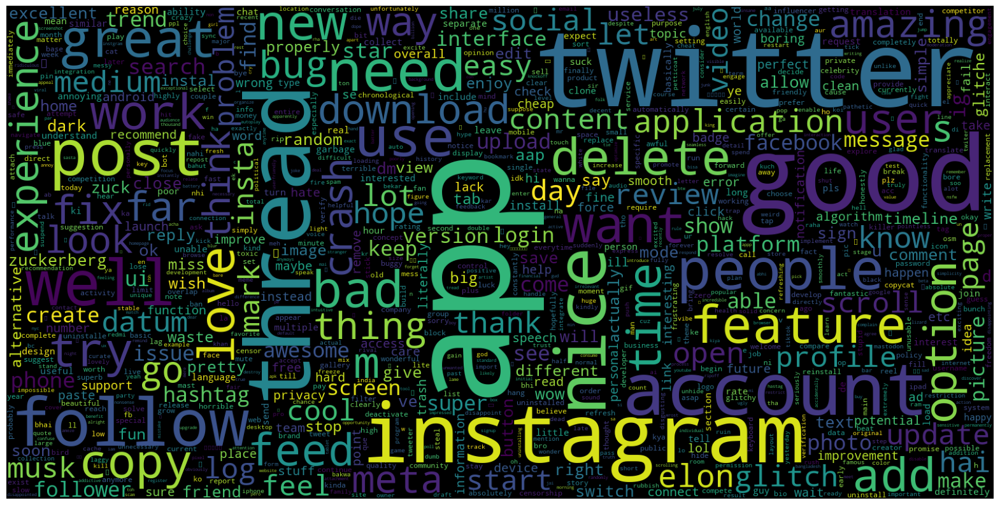

In [92]:
data = df_new.review_description
plt.figure(figsize = (20,20))
wc = WordCloud(max_words = 1000, width = 1600, height = 800, collocations = False).generate(" ".join(data))
plt.imshow(wc)
plt.axis('off')
plt.show()

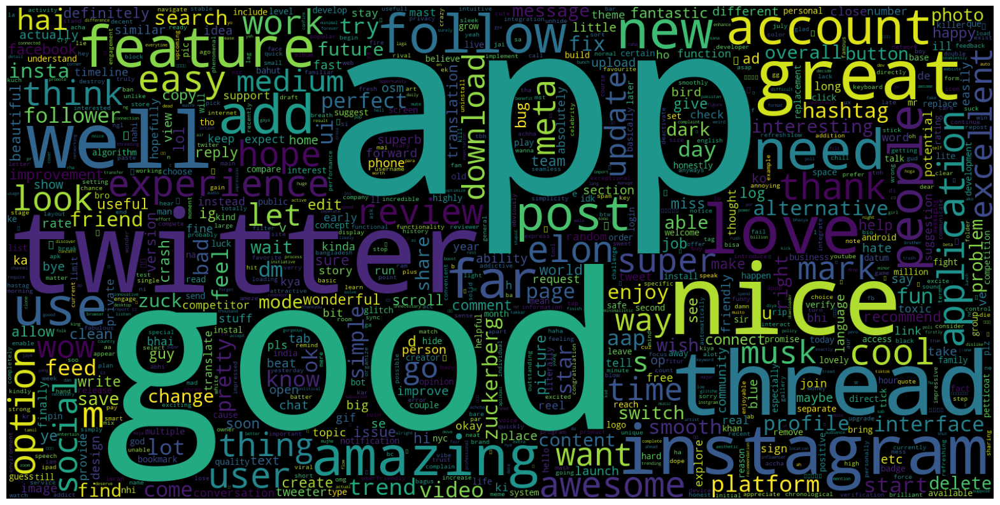

In [93]:
data = df_new[df_new['rating'] == 1]['review_description']
plt.figure(figsize = (20,20))
wc = WordCloud(max_words = 1000 , width = 1600 , height = 800,
               collocations=False).generate(" ".join(data))
plt.imshow(wc)
plt.axis('off')
plt.show()

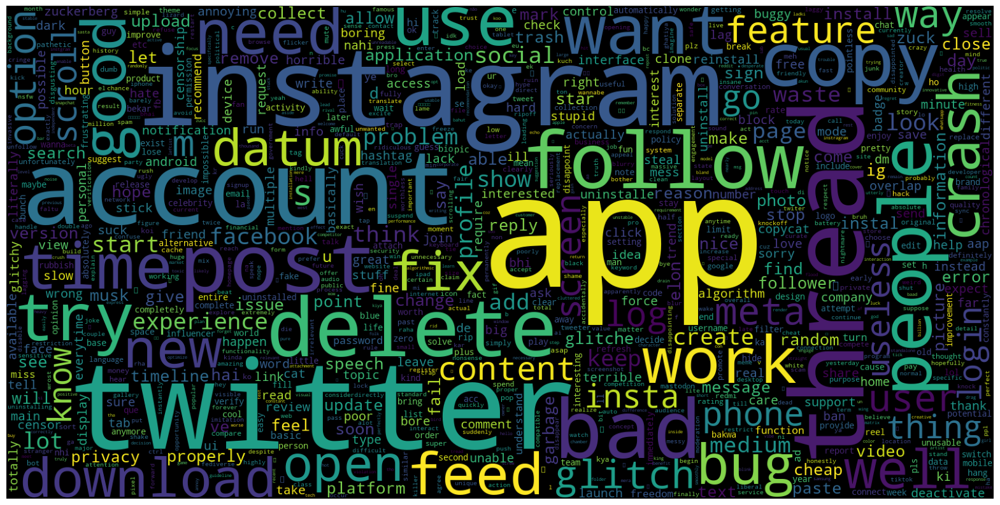

In [94]:
data = df_new[df_new['rating'] == -1]['review_description']
plt.figure(figsize = (20,20))
wc = WordCloud(max_words = 1000 , width = 1600 , height = 800,
               collocations=False).generate(" ".join(data))
plt.imshow(wc)
plt.axis('off')
plt.show()

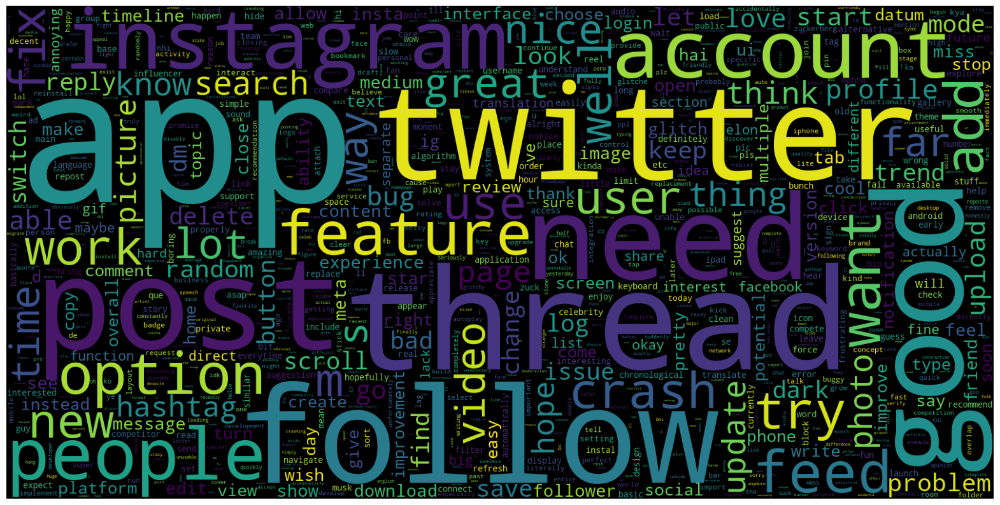

In [95]:
data = df_new[df_new['rating'] == 0]['review_description']
plt.figure(figsize = (20,20))
wc = WordCloud(max_words = 1000 , width = 1600 , height = 800,
               collocations=False).generate(" ".join(data))
plt.imshow(wc)
plt.axis('off')
plt.show()

In [96]:
from sklearn.feature_extraction.text import TfidfVectorizer
import pickle

In [97]:
tf1 = TfidfVectorizer()
data_vec = tf1.fit_transform(df1['review_description'])

In [98]:
data_vec

<32909x18954 sparse matrix of type '<class 'numpy.float64'>'
	with 326797 stored elements in Compressed Sparse Row format>

In [99]:
with open('tfidf.pkl', 'wb') as model_file:
    pickle.dump(tf1, model_file)

In [100]:
y = df_new['rating'].values

In [101]:
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.model_selection import train_test_split

In [102]:
X_train,X_test,y_train,y_test = train_test_split(data_vec, y, test_size = 0.2, stratify = y, random_state=42)

In [103]:
from imblearn.over_sampling import SMOTE

In [104]:
smote = SMOTE(random_state = 42)
x_balanced, y_balanced = smote.fit_resample(X_train, y_train)
#just balancing only trained data

In [105]:
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

In [106]:
sv = SVC()

In [107]:
model_sv = sv.fit(x_balanced, y_balanced)

In [108]:
y_pred_sv = model_sv.predict(X_test)

In [109]:
model_filename = 'svm.pkl'
with open(model_filename, 'wb') as model_file:
    pickle.dump(model_sv, model_file)

In [110]:
print(accuracy_score(y_test, y_pred_sv))

0.781069583713157


In [111]:
print(confusion_matrix(y_test, y_pred_sv))

[[1796   67  441]
 [ 208   53  256]
 [ 237  232 3292]]


In [112]:
print(classification_report(y_test, y_pred_sv))

              precision    recall  f1-score   support

          -1       0.80      0.78      0.79      2304
           0       0.15      0.10      0.12       517
           1       0.83      0.88      0.85      3761

    accuracy                           0.78      6582
   macro avg       0.59      0.59      0.59      6582
weighted avg       0.76      0.78      0.77      6582

